# The Neural Dynamics of Valence and Intensity Encoding in the Amygdala and Prefrontal Cortex

**Authors:** Rahim Hashim, Roberto Gulli, Stefano Fusi, Daniel Salzman <br>
**Notebook Owner:** Rahim Hashim (rh2898@columbia.edu) <br>
***

## Import Libraries and Setting Path Variables

Make sure that all the libraries specified in environment.yaml are installed (see [pip](https://packaging.python.org/en/latest/tutorials/installing-packages/) documentation for more info). The structure of the directory should be:
```
ROOT
│
└───data
│   │
│   └─── raw
│   │    │   data_<TASK>
│   └─── processed
│   │    │   data_<TASK>
│   └─── _fractals
│       │   <YYYYMMDD>
│
└─── tasks
    │
    └─── EXPERIMENT
        │   
        └─── <TASK>  
            │   <videos>     

```

In [10]:
%load_ext autoreload
%autoreload 2
import os
import sys
import numpy as np
import pandas as pd
from pprint import pprint
import matplotlib.pyplot as plt
# Custom classes
from classes.Path import Path
from classes.Session import Session
# pandas options
pd.options.mode.chained_assignment = None  # default='warn'
pd.set_option('display.max_columns', None)

# Assign paths
ROOT = '/Users/rahimhashim/Google Drive/My Drive/Columbia/Salzman/Monkey-Training/'
EXPERIMENT = 'rhAirpuff'
TASK = 'Probabilistic_Reward_Airpuff_Choice' # Probabalistic_Airpuff_4x2 | Probabilistic_Reward_Airpuff_5x2 | Probabilistic_Reward_Airpuff_Choice

path_obj = Path(ROOT, EXPERIMENT, TASK)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Raw Data Path Exists: /Users/rahimhashim/Google Drive/My Drive/Columbia/Salzman/Monkey-Training/data/raw/data_Probabilistic_Reward_Airpuff_Choice
  Number of Files  : 28
  Earliest Date    : 230523
  Most Recent Date : 230627
Video Path Exists: /Users/rahimhashim/Google Drive/My Drive/Columbia/Salzman/Monkey-Training/tasks/rhAirpuff/8. Probabilistic_Reward_Airpuff_Choice/videos
Pulling '.h5' files...
  Complete: 26 '.h5' files pulled


***
## Specifying Session and Analyses Parameters
Choose the date(s) and monkey(s) that you'd like to include in your analysis. 
> `reprocess_data` <br>
> * `True` : generates (or regenerates) the session_df DataFrame from `data/raw` data <br>
> * `False` : loads the pickled session_df DataFrame from the `data/processed` data directory

> `save_df` <br>
> * `True` : pickles the generated session_df DataFrame and saves it in the `data/processed` data directory
> * `False` : does not pickle the session_df DataFrame

> `combine_dates` <br>
> * `True` : runs all analyses on a combined DataFrame and saves figures for all sessions
> * `False` : does not combine analyses and generates new figures for each date

In [2]:
# Custom modules
from config import preprocess_helper

# Specifying date/monkey/task
start_date = '2023-06-27' #@param {type:"date"}
end_date = '2023-06-27' #@param {type:"date"}
monkey_input = 'Bear' #@param ['Aragorn', 'Gandalf', 'Rob', 'Test']
reprocess_data = True #@param {type:"boolean"}
save_df =  True #@param {type:"boolean"}
combine_dates =  True #@param {type:"boolean"}

# Parse data
session_df, session_obj, error_dict, behavioral_code_dict\
	= preprocess_helper.preprocess_data(path_obj,
																			start_date,
																			end_date,
																			monkey_input,
																			TASK,
																			reprocess_data,
																			save_df,
																			combine_dates)

session_df_correct = session_df[session_df['correct'] == 1]

Loading selected file(s):
  230627_Bear_choice.h5 - Completed
Converting .h5 to python:
  <HDF5 file "230627_Bear_choice.h5" (mode r)>
Parsing .h5 file...
  Cam 1 assigned
  Cam 2 assigned
  Trial and Camera numbers matched.
Total number of trials: 785
  Choice task detected.
Parsing session data...


  0%|          | 0/785 [00:00<?, ?it/s]

  Complete.
    Correct trials: 401
    Errored trials: 384
Parsing camera data...


  0%|          | 0/785 [00:00<?, ?it/s]

  0%|          | 0/785 [00:00<?, ?it/s]

  Complete.
Creating Session Objects...
  Min Values (X,Y): (-29.197,-25.656)
  Max Values (X,Y): (88.009,128.428)
Adding additional fields to session_df DataFrame...


/Users/rahimhashim/Desktop/Monkey-Behavior/config/add_fields.py:324: RuntimeWarning: Mean of empty slice
  lick_avg = np.nanmean(lick_in_window)


  20 new fields added.
Saving .pickle files to: /Users/rahimhashim/Google Drive/My Drive/Columbia/Salzman/Monkey-Training/data/processed/processed_Probabilistic_Reward_Airpuff_Choice
  Pickling 230627_Bear_Probabilistic_Reward_Airpuff_5x2_behave.pkl
  Total time to pickle: 0.4526 sec
  Index(['date', 'session_num', 'subject', 'trial_num', 'block', 'condition',
         'correct', 'error', 'error_type', 'behavioral_code_markers',
         'behavioral_code_times', 'stimuli_name_1', 'x_1_pos', 'y_1_pos',
         'stimuli_name_2', 'x_2_pos', 'y_2_pos', 'reward_1', 'reward_prob_1',
         'reward_mag_1', 'reward_drops_1', 'reward_length_1', 'reward_2',
         'reward_prob_2', 'reward_mag_2', 'airpuff_1', 'airpuff_prob_1',
         'airpuff_mag_1', 'airpuff_2', 'airpuff_prob_2', 'airpuff_mag_2',
         'eye_x', 'eye_y', 'eye_pupil', 'lick', 'photodiode', 'trial_start',
         'trial_datetime_start', 'trial_datetime_end', 'reinforcement_trial',
         'choice_trial', 'stim_chosen',

### View DataFrame Headers

Peek into the session_df DataFrame to see the fields included.

In [3]:
pd.set_option('display.max_columns', None)
session_df_correct.head(5)

,date,session_num,subject,trial_num,block,condition,correct,error,error_type,behavioral_code_markers,behavioral_code_times,stimuli_name_1,x_1_pos,y_1_pos,stimuli_name_2,x_2_pos,y_2_pos,reward_1,reward_prob_1,reward_mag_1,reward_drops_1,reward_length_1,reward_2,reward_prob_2,reward_mag_2,airpuff_1,airpuff_prob_1,airpuff_mag_1,airpuff_2,airpuff_prob_2,airpuff_mag_2,eye_x,eye_y,eye_pupil,lick,photodiode,trial_start,trial_datetime_start,trial_datetime_end,reinforcement_trial,choice_trial,stim_chosen,stim_2_chosen,fractal_chosen,reward,reward_mag,airpuff,airpuff_mag,cam1_trial_name,cam1_trial_time,cam1_video,cam2_trial_name,cam2_trial_time,cam2_video,Start Trial,Fixation On,Fixation Success,CS On,Fixation Off,Trace Start,Trace End,Outcome Start,Reward Trigger,Airpuff Trigger,Outcome,Outcome End,Manual Reward,End Trial,valence,valence_1,valence_2,lick_raster,DEM_raster,trial_bins,trial_in_block,fractal_count_in_block,lick_count_window,blink_count_window,pupil_data_window,pupil_raster,pupil_raster_window,pupil_raster_window_avg,pupil_binary_zero,blink_onset,blink_offset,blink_raster,blink_raster_window,blink_duration_window,pupil_pre_CS,lick_in_window,blink_in_window,lick_duration,blink_duration_sig,blink_duration_offscreen,eye_distance
0,230627,0,Bear,1,1,1,1,0,0,"[9, 100, 101, 102, 103, 104, 105, 106, 107, 10...","[12.931599980220199, 105.31519999494776, 260.9...",_fractal_B,[0.0],[0.0],_fractal_B,[0.0],[0.0],1,1.0,0.75,8.0,200.0,0,0.0,0.0,0,0.0,0.0,0,0.0,0.0,"[-0.08100562181212419, -0.08100562181212419, -...","[1.8775438368129138, 1.8775438368129138, 1.898...","[7238.0, 7238.0, 7252.0, 7254.0, 7254.0, 7254....","[0.005924517546271019, 0.005595690320483099, 0...","[0.009541617025162694, 0.00987044425008303, 0....",0.0000,2023-06-27 13:14:25.864,2023-06-27 13:14:31.406,1,0,2,0,_fractal_B,1,0.75,0,0.0,230627_Bear_choice_Cam1_1,"[-122.31122000001449, -88.97292000000334, -55....",NaN,230627_Bear_choice_Cam2_1,"[87.49376000000098, 615.0375600000046, 1143.06...",NaN,105,260,768,796,1047,1431,2919,2923,2941,<NA>,2950,5439,<NA>,5490,0.75,0.75,0.0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",5542,0,1,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[6669.0, 6669.0, 6669.0, 6669.0, 6669.0, 6669....","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.00,0.0,[],[],"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.000000,"[6766.0, 6764.0, 6764.0, 6761.0, 6761.0, 6758....",1.0,1.0,0.822667,0.00,0.442667,111.057669
3,230627,0,Bear,4,1,1,1,0,0,"[9, 100, 101, 102, 103, 104, 105, 106, 107, 10...","[1965.9999000141397, 1984.6605000202544, 2069....",_fractal_A,[0.0],[0.0],_fractal_A,[0.0],[0.0],1,1.0,1.00,10.0,150.0,0,0.0,0.0,0,0.0,0.0,0,0.0,0.0,"[-2.7737276740246655, -2.764940145641613, -2.7...","[31.483170706028844, 31.4882191559481, 31.4882...","[7014.0, 7014.0, 7014.0, 7017.0, 7017.0, 7017....","[0.005924517546271019, 0.005266863094622737, 0...","[0.010528098699707306, 0.010856925924411315, 0...",15238.3540,2023-06-27 13:14:41.103,2023-06-27 13:14:48.652,1,0,1,0,_fractal_A,1,1.00,0,0.0,230627_Bear_choice_Cam1_4,"[0.5903800281139411, 33.92868002811156, 67.266...",NaN,230627_Bear_choice_Cam2_4,"[305.2413600281343, 849.2459600281272, 1377.20...",NaN,1984,2069,2821,2836,3070,3454,4940,4944,4957,<NA>,4973,7465,<NA>,7498,1.00,1.00,0.0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...",7548,3,1,"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[6708.0, 6708.0, 6708.0, 6711.0, 6718.0, 6718....","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.00,0.0,"[1987, 6749]","[2244, 6942]","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 

***
## Run Analyses

`run_functions` performs all the analyses on session_df.

  perf_by_fractal.png saved.


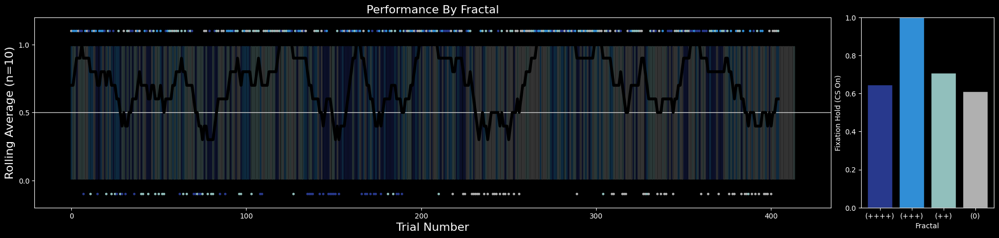

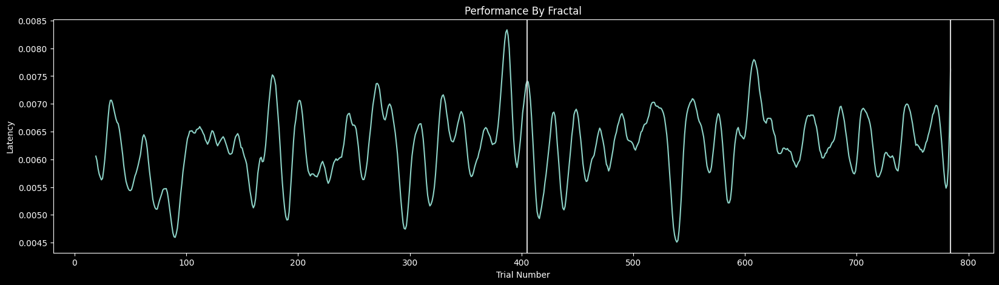

  epoch_hist.png saved.


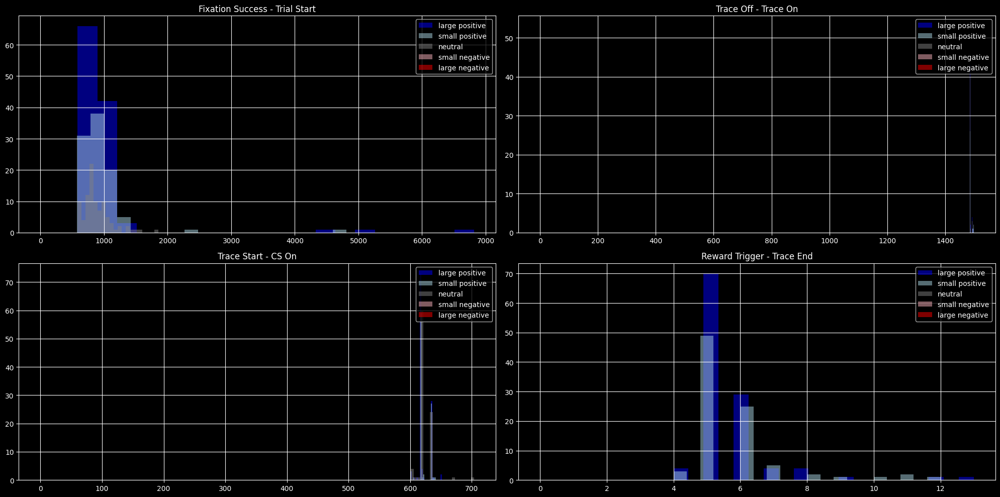

  lick_vs_blink.png saved.
    Session lick failed, likely not enough trials in each condition...
  fractal_lick_raster.png saved.
  fractal_blink_raster.png saved.
  raster_by_cond_1.png saved.
  t_test_lick-duration_1.png saved.


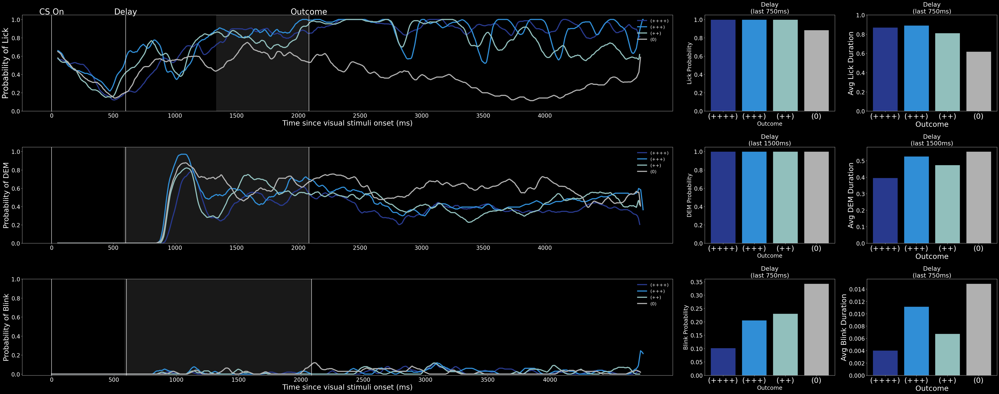

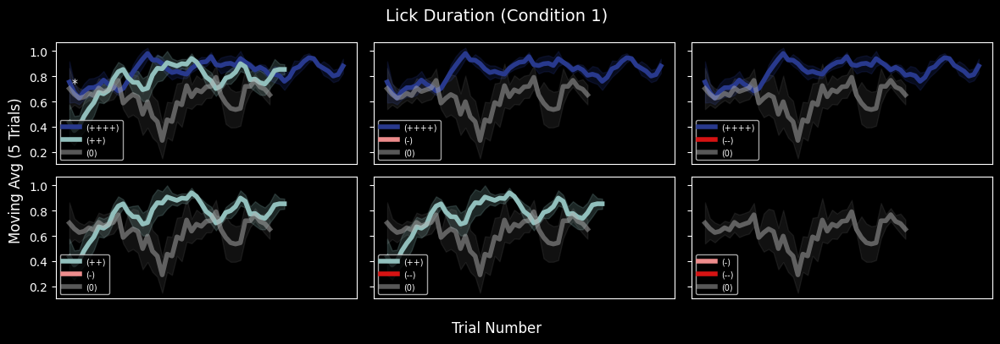

  t_test_DEM-duration_1.png saved.


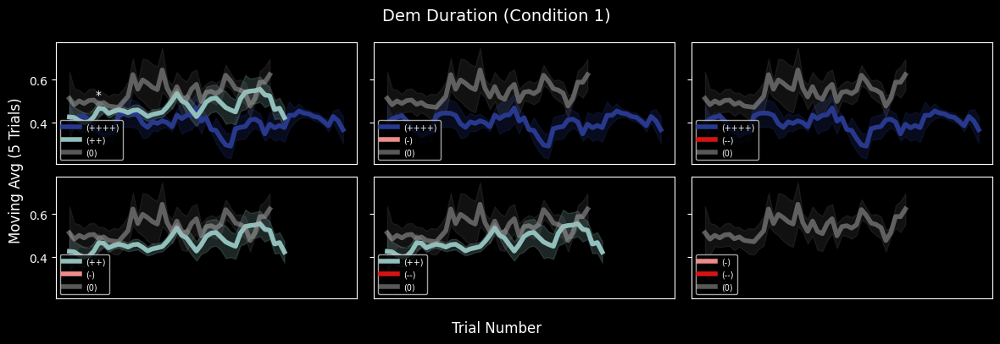

  t_test_blink-duration_1.png saved.


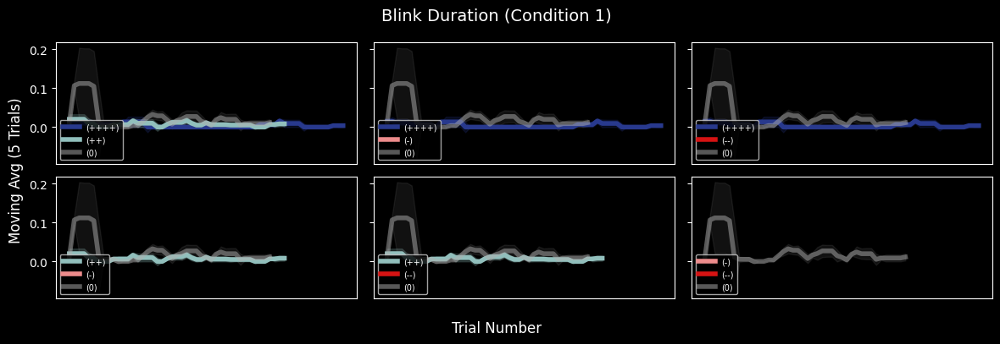

  raster_by_cond_2.png saved.
  t_test_lick-duration_2.png saved.


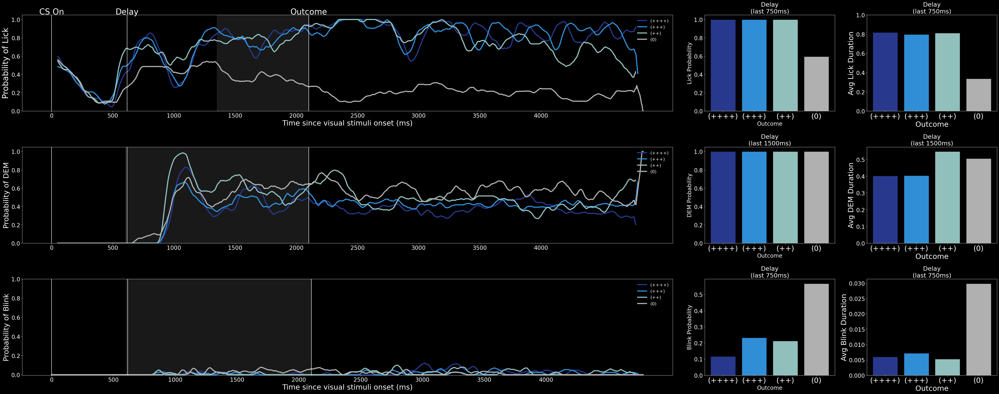

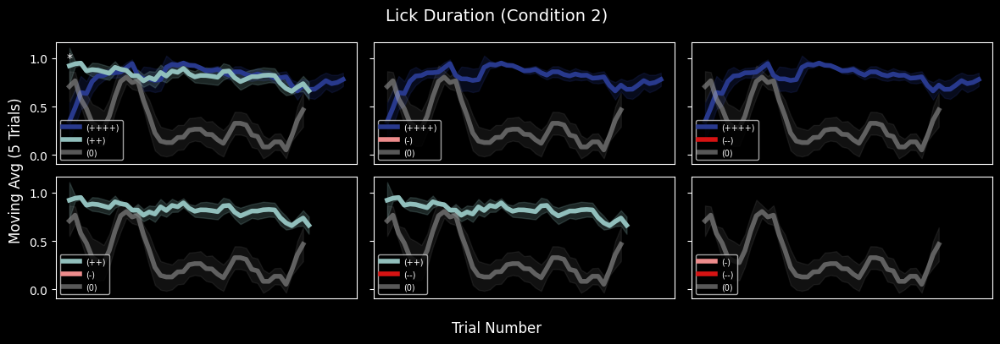

  t_test_DEM-duration_2.png saved.


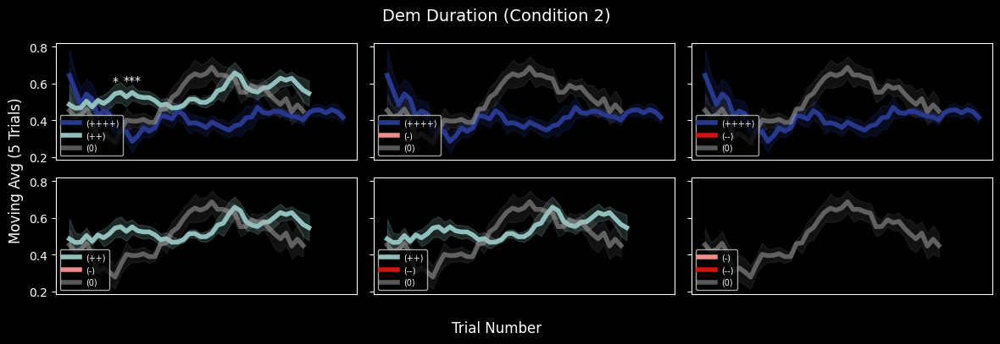

  t_test_blink-duration_2.png saved.


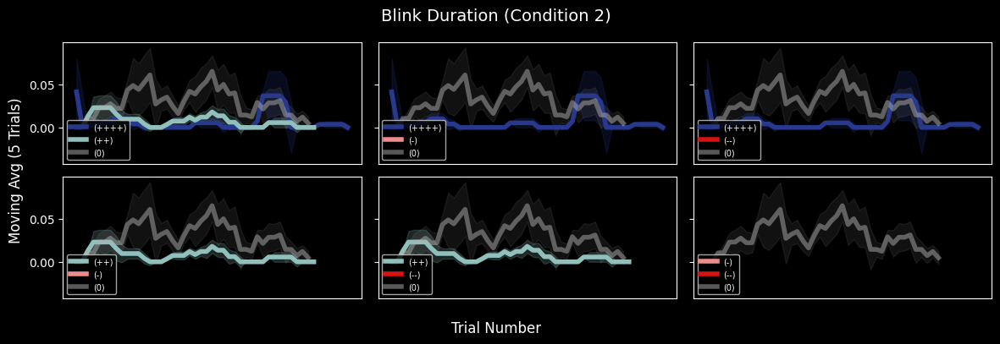

 [0.0, 0.5, 0.75, 1.0] ANOVA 55.354 | P-value: 6.03E-27
  (0, 1) T-value: -7.816 P-value: 4.57E-11 |  Z-value: -8.066 P-value: 7.24E-16
    0 Lick Mean: 0.431 Lick Std: 0.335 Trials: 52
    1 Lick Mean: 0.828 Lick Std: 0.146 Trials: 57
  (0, 2) T-value: -8.227 P-value: 1.38E-11 |  Z-value: -8.634 P-value: 5.93E-18
    0 Lick Mean: 0.431 Lick Std: 0.335 Trials: 52
    2 Lick Mean: 0.84 Lick Std: 0.125 Trials: 59
  (0, 3) T-value: -8.179 P-value: 1.59E-11 |  Z-value: -8.878 P-value: 6.82E-19
    0 Lick Mean: 0.431 Lick Std: 0.335 Trials: 52
    3 Lick Mean: 0.838 Lick Std: 0.133 Trials: 65
  (1, 2) T-value: -0.453 P-value: 6.52E-01 |  Z-value: -0.454 P-value: 6.50E-01
    1 Lick Mean: 0.828 Lick Std: 0.146 Trials: 57
    2 Lick Mean: 0.84 Lick Std: 0.125 Trials: 59
  (1, 3) T-value: -0.383 P-value: 7.02E-01 |  Z-value: -0.386 P-value: 7.00E-01
    1 Lick Mean: 0.828 Lick Std: 0.146 Trials: 57
    3 Lick Mean: 0.838 Lick Std: 0.133 Trials: 65
  (2, 3) T-value: 0.073 P-value: 9.42E-01 |  Z

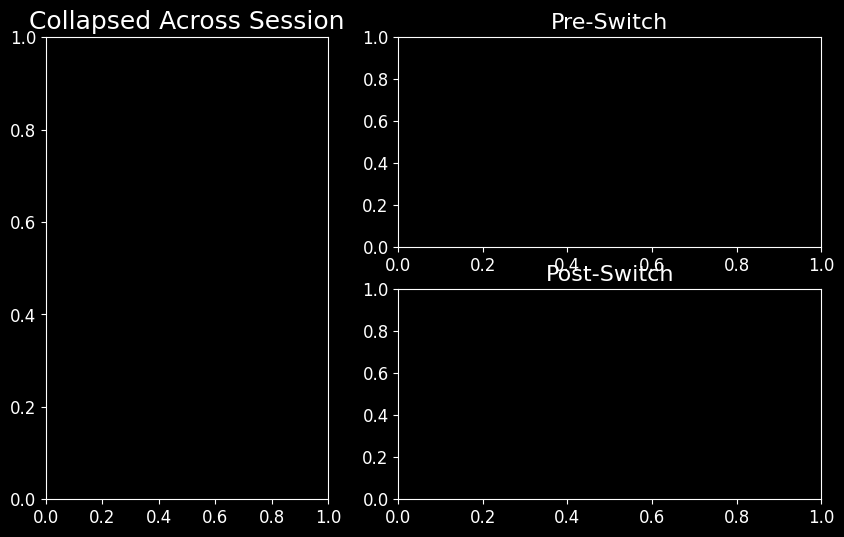

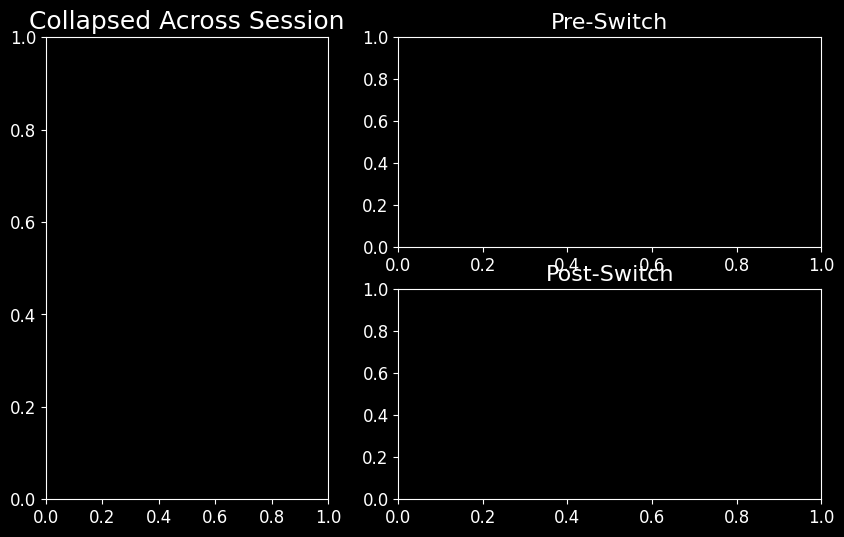

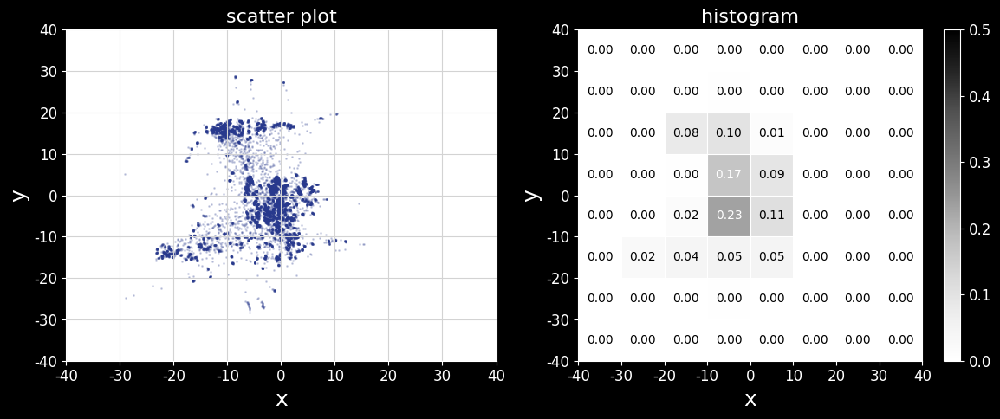

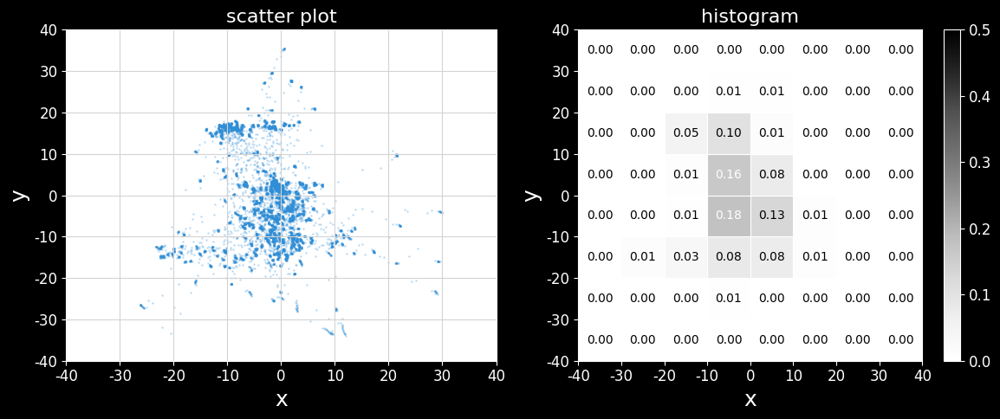

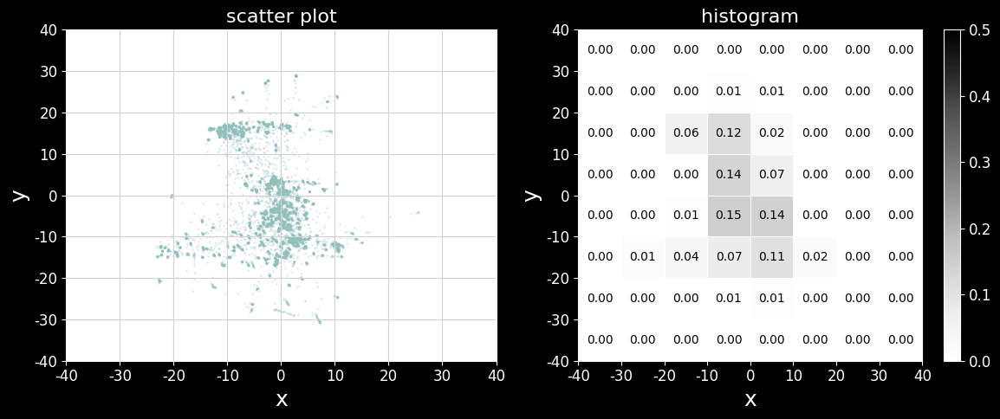

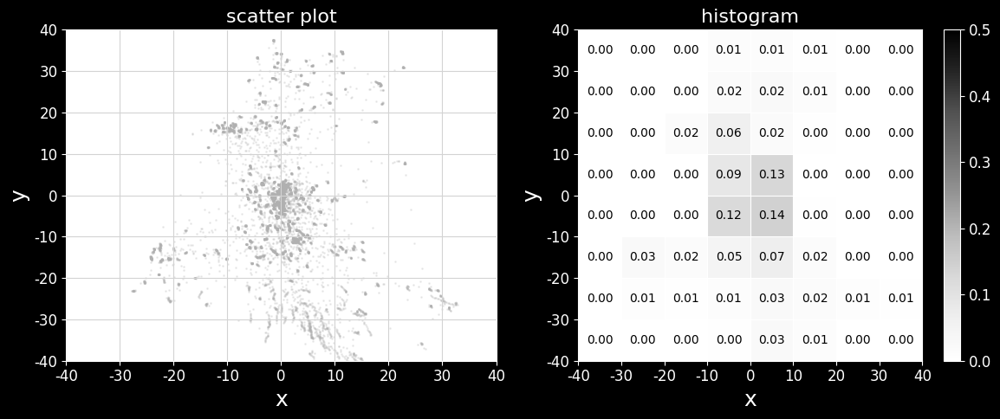

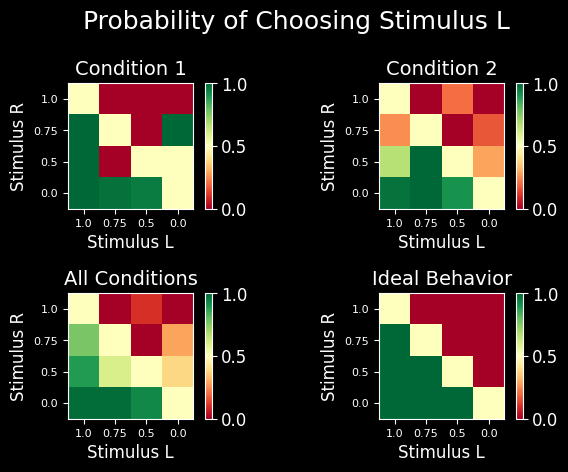

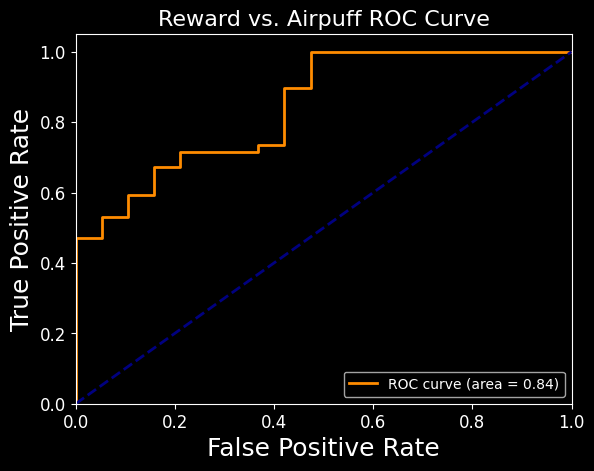

Large Reward vs. Small Reward Accuracy: 0.68 (+/- 0.08)
  lick_duration: 0.555
  blink_duration_offscreen: -0.814
  pupil_raster_window_avg: 0.001
  blink_duration_window: -0.13
  eye_distance: 0.002


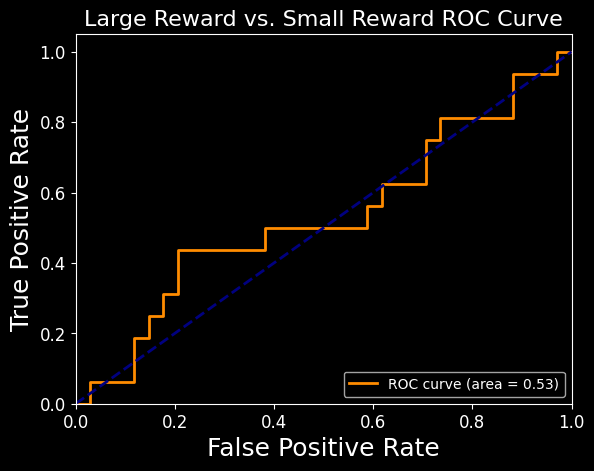


Generating session summary: /Users/rahimhashim/Google Drive/My Drive/Columbia/Salzman/Monkey-Training/docs/Tracker/Emotion/markdowns
  Writing 20230627_Bear.md
Writing to excel...
  Writing 230627 to Emotion_Tracker.xlsx


In [9]:
plt.style.use('dark_background')
from analyses.run_functions import run_functions

# dates = [date for date in dates if date not in ['230607', '230609']]
dates = session_df['date'].unique()
for date in dates:
	session_df_date = session_df[session_df['date'] == date]
	session_obj = run_functions(session_df_date, session_obj, path_obj, 
														  behavioral_code_dict, error_dict)

In [7]:
session_obj.valence_labels

defaultdict(str,
            {-1: '(--)',
             -0.5: '(-)',
             0: '(0)',
             0.5: '(++)',
             0.75: '(+++)',
             1: '(++++)',
             'valence_1': ''})

## Reinforcement Trials Only

In [29]:
# CS On is not NaN (otherwise errors not relevant)
session_df_cs_on = session_df[session_df['CS On'].notna()]
# Reinforcement Trials only
session_df_reinforcement = session_df_cs_on[session_df_cs_on['reinforcement_trial'] == 1]
correct_reinforcement_trials = session_df_reinforcement[session_df_reinforcement['correct'] == 1]
# Reinforcement Trial Calculation
print(f'Percent correct reinforcement trials: {round(len(correct_reinforcement_trials)/len(session_df_reinforcement), 3)} ({len(correct_reinforcement_trials)}/{len(session_df_reinforcement)})')

# Valence Calculation
all_valences = sorted(session_df['valence'].unique(), reverse=True)
for v_index, valence in enumerate(all_valences):
  # Valence 1 -- due to task code structure but I will fix
  session_df_valence = session_df_reinforcement[session_df_reinforcement['valence_1'] == valence]
  # Filter for correct trials
  session_df_valence_correct = session_df_valence[session_df_valence['correct'] == 1]
  # Calculate percent correct
  percent_correct = round(len(session_df_valence_correct)/len(session_df_valence), 3)
  # Print percent correct by valence
  print(f'  Valence {valence}: {percent_correct} ({len(session_df_valence_correct)}/{len(session_df_valence)})')

session_df_choice = session_df_cs_on[session_df_cs_on['choice_trial'] == 1]
correct_choice_trials = session_df_choice[session_df_choice['correct'] == 1]

# Choice Trial Calculation
print(f'Percent correct choice trials: {round(len(correct_choice_trials)/len(session_df_choice), 3)} ({len(correct_choice_trials)}/{len(session_df_choice)})')


Percent correct reinforcement trials: 0.856 (346/404)
  Valence 1.0: 1.0 (76/76)
  Valence 0.5: 0.987 (75/76)
  Valence 0.0: 0.815 (44/54)
  Valence -0.5: 0.73 (73/100)
  Valence -1.0: 0.796 (78/98)
Percent correct choice trials: 0.597 (105/176)


## Comparing Reinforcement and Choice Trial Performance

In [24]:
session_df_reinforcement = session_df_correct[session_df_correct['reinforcement_trial'] == 1]
session_df_reinforcement.groupby(['valence'])\
              [['lick_duration',
                'blink_duration_offscreen',
                'pupil_raster_window_avg',
                'blink_duration_window',
                'eye_distance']].mean()

,lick_duration,blink_duration_offscreen,pupil_raster_window_avg,blink_duration_window,eye_distance
valence,,,,,
-1.0,0.337265,0.614675,0.169179,0.232308,72.598206
-0.5,0.442484,0.572566,0.109470,0.155671,75.116211
0.0,0.398667,0.539227,0.108621,0.171485,79.764042
0.5,0.861564,0.370889,0.027991,0.050640,59.093583
1.0,0.889316,0.357868,0.015579,0.026842,51.385893


In [25]:
session_df_reinforcement.groupby(['condition', 'fractal_chosen'])\
              [['valence', 'lick_duration',
                'blink_duration_offscreen',
                'pupil_raster_window_avg',
                'blink_duration_window',
                'eye_distance']].mean()

valence  lick_duration  blink_duration_offscreen   
condition fractal_chosen                                                     
1         _fractal_A          1.0       0.944610                  0.412286  \
          _fractal_B          0.5       0.910362                  0.455086   
          _fractal_C          0.0       0.403111                  0.583000   
          _fractal_D         -0.5       0.404419                  0.542286   
          _fractal_E         -1.0       0.357519                  0.628907   
2         _fractal_A         -0.5       0.477544                  0.600456   
          _fractal_B         -1.0       0.319905                  0.602476   
          _fractal_C          0.0       0.393333                  0.486700   
          _fractal_D          1.0       0.842114                  0.311415   
          _fractal_E          0.5       0.818867                  0.297217   

                          pupil_raster_window_avg  blink_duration_window   
condition fractal_chosen                                                   
1         _fractal_A                     0.024000               0.035029  \
          _fractal_B                     0.044933               0.081238   
          _fractal_C                     0.149917               0.231722   
          _fractal_D                     0.082895               0.133238   
          _fractal_E                     0.214574               0.293741   
2         _fractal_A                     0.133947               0.176333   
          _fractal_B                     0.130270               0.179651   
          _fractal_C                     0.059067               0.099200   
          _fractal_D                     0.008390               0.019854   
          _fractal_E                     0.013167               0.023867   

                          eye_distance  
condition fractal_chosen                
1         _fractal_A         51.836151  
          _fractal_B         60.177376  
          _fractal_C         67.483483  
          _fractal_D         85.870594  
          _fractal_E         72.533188  
2         _fractal_A         65.210858  
          _fractal_B         72.653935  
          _fractal_C         94.500714  
          _fractal_D         51.001526  
          _fractal_E         58.145264

In [ ]:
def trialno_lick_blink_correlation(df, session_obj):
  f, ax = plt.subplots(1, 1, figsize=(5, 5))
  df_threshold = df[df['fractal_count_in_block'] > 10]
  for block in df_threshold['condition'].unique():
    df_block = df_threshold[df_threshold['condition'] == block]
    print(f'Block: {block}')
    for valence in sorted(df_block['valence'].unique(), reverse=True):
      df_block_valence = df_block[df_block['valence'] == valence]
      trialno_lick_corr = round(df_block_valence['fractal_count_in_block'].corr(df_block_valence['lick_duration']), 3)
      trial_no_blink_corr = round(df_block_valence['fractal_count_in_block'].corr(df_block_valence['blink_duration_window']), 3)
      print(f'  Valence {valence}: Lick Correlation: {trialno_lick_corr} | Blink Correlation: {trial_no_blink_corr}')
      ec = 'black' if block == 1 else 'white'
      ax.scatter(trialno_lick_corr, trial_no_blink_corr, s=150,
                label=None, 
                color=session_obj.valence_colors[valence], ec=ec)
      ax.set_xlabel('Trial Number vs. Lick Duration Correlation', fontsize=14)
      ax.set_ylabel('Trial Number vs. Blink Duration Correlation', fontsize=14)
  ax.set_xlim(-0.5, 0.5)
  ax.set_ylim(-0.5, 0.5)
  plt.show()
    
trialno_lick_blink_correlation(session_df_correct, session_obj)

In [ ]:
plt.style.use('dark_background')
blink_trials = session_df_correct[session_df_correct['pupil_binary_zero'] == 1].index.tolist()

In [ ]:
from distance_analysis import calc_eye_dist
blink_bin_threshold = 20
session_df_correct = \
	session_df_correct.apply(calc_eye_dist, session_obj=session_obj, blink_bin_threshold=blink_bin_threshold, axis=1)


In [ ]:
from distance_analysis import plot_eye_dist_histogram
plot_eye_dist_histogram(session_df_correct)

In [ ]:
from pupil_analysis import pupil_valence_no_blink, pupil_preblink
pupil_valence_no_blink(session_df_correct, session_obj)
pupil_preblink(session_df_correct, session_obj)

In [ ]:
session_df_correct['Fixation Duration'] = session_df_correct['Fixation Success'] - session_df_correct['Fixation On']
session_df_correct['CS Duration'] = session_df_correct['CS Off'] - session_df_correct['CS On']
session_df_correct['Trace Duration'] = session_df_correct['Trace End'] - session_df_correct['Trace Start']
session_df_correct['Outcome Duration'] = session_df_correct['Outcome End'] - session_df_correct['Outcome Start']
session_df_correct['Trial Duration'] = session_df_correct['End Trial'] - session_df_correct['Fixation Success']

In [ ]:
session_df_positive = session_df_correct[session_df_correct['valence'] == 1]
session_df_positive['Trace_to_Outcome'] = session_df_positive['Reward Trigger'] - session_df_positive['Outcome Start']
session_df_positive[['valence', 'Fixation Duration', 'CS Duration', 'Trace Duration', 'Trace_to_Outcome', 'Outcome Duration', 'Trial Duration']].mean()

In [ ]:
session_df_positive = session_df_correct[session_df_correct['valence'] == 0.5]
session_df_positive['Trace_to_Outcome'] = session_df_positive['Reward Trigger'] - session_df_positive['Outcome Start']
session_df_positive[['valence', 'Fixation Duration', 'CS Duration', 'Trace Duration', 'Trace_to_Outcome', 'Outcome Duration', 'Trial Duration']].mean()

In [ ]:
session_df_negative = session_df_correct[session_df_correct['valence'] == -0.5]
session_df_negative['Trace_to_Outcome'] = session_df_negative['Airpuff Trigger'] - session_df_negative['Outcome Start']
session_df_negative[['valence', 'Fixation Duration', 'CS Duration', 'Trace Duration', 'Trace_to_Outcome', 'Outcome Duration', 'Trial Duration']].mean()

In [ ]:
session_df_negative = session_df_correct[session_df_correct['valence'] == -1]
session_df_negative['Trace_to_Outcome'] = session_df_negative['Airpuff Trigger'] - session_df_negative['Outcome Start']
session_df_negative[['valence', 'Fixation Duration', 'CS Duration', 'Trace Duration', 'Trace_to_Outcome', 'Outcome Duration', 'Trial Duration']].mean()

***
## Exploratory Analysis
### High Lick + Low DEM/Blink Trials

In [78]:
session_df_correct.loc[(session_df_correct['blink_in_window'] == 0) & 
											 (session_df_correct['eye_distance'] < 20) &
											 (session_df_correct['lick_duration'] > 0.75)]

,date,session_num,subject,trial_num,block,condition,correct,error,error_type,behavioral_code_markers,behavioral_code_times,stimuli_name_1,x_1_pos,y_1_pos,stimuli_name_2,x_2_pos,y_2_pos,reward_1,reward_prob_1,reward_mag_1,reward_drops_1,reward_length_1,reward_2,reward_prob_2,reward_mag_2,airpuff_1,airpuff_prob_1,airpuff_mag_1,airpuff_2,airpuff_prob_2,airpuff_mag_2,eye_x,eye_y,eye_pupil,lick,photodiode,trial_start,trial_datetime_start,trial_datetime_end,reinforcement_trial,choice_trial,stim_chosen,stim_2_chosen,fractal_chosen,reward,reward_mag,airpuff,airpuff_mag,valence,cam1_trial_name,cam1_trial_time,cam1_video,cam2_trial_name,cam2_trial_time,cam2_video,Start Trial,Fixation On,Fixation Success,CS On,Fixation Off,Trace Start,Trace End,Outcome Start,Reward Trigger,Airpuff Trigger,Outcome,Outcome End,Manual Reward,End Trial,valence_1,valence_2,lick_raster,DEM_raster,trial_bins,trial_in_block,fractal_count_in_block,lick_count_window,blink_count_window,pupil_data_window,pupil_raster,pupil_raster_window,pupil_raster_window_avg,pupil_binary_zero,blink_onset,blink_offset,blink_raster,blink_raster_window,blink_duration_window,pupil_pre_CS,lick_in_window,blink_in_window,lick_duration,blink_duration_sig,blink_duration_offscreen,eye_distance
69,230530,0,Aragorn,70,1,1,1,0,0,"[9, 100, 101, 102, 103, 104, 105, 106, 107, 10...","[1965.9427000001415, 1972.9527000004055, 2036....",_fractal_A,[0.0],[0.0],_fractal_A,[0.0],[0.0],1,1.0,1.0,8.0,220.0,0,0.0,0.0,0,0.0,0.0,0,0.0,0.0,"[-12.163498817917436, -12.163498817917436, -12...","[-10.960824656277545, -10.960824656277545, -10...","[8163.0, 8163.0, 8163.0, 8163.0, 8163.0, 8163....","[0.0062533447719864965, 0.00658217199762956, 0...","[0.00987044425008303, 0.00921278980017022, 0.0...",4.980118e+05,2023-05-30 15:44:10.523,2023-05-30 15:44:18.185,1,0,1,0,_fractal_A,1,1,0,0,1.0,230530_Aragorn_choice_Cam1_70,"[-85.27365999988979, -51.935359999828506, -18....",NaN,230530_Aragorn_choice_Cam2_70,"[193.47168000019155, 721.4845800002222, 1265.4...",NaN,1972,2036,2921,2936,3170,3554,5041,5043,5047,<NA>,5056,7562,<NA>,7612,1.0,0.0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...",7662,69,18,"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[7786.0, 7787.0, 7787.0, 7789.0, 7789.0, 7785....","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.0,0.0,[3652],[3862],"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.0,"[7043.0, 7043.0, 7043.0, 7043.0, 7036.0, 7036....",1.0,0.0,1.000000,0.0,0.0,14.375362
95,230530,0,Aragorn,96,1,1,1,0,0,"[9, 100, 101, 102, 103, 104, 105, 106, 107, 10...","[1966.6173000000526, 1973.1576999997742, 2036....",_fractal_A,[-5.0],[0.0],_fractal_C,[5.0],[0.0],1,1.0,1.0,8.0,220.0,0,0.0,0.0,0,0.0,0.0,0,0.0,0.0,"[-20.638097041474133, -19.418126451913007, -19...","[-13.735196456873403, -13.937035294295448, -13...","[8298.0, 8319.0, 8319.0, 8354.0, 8354.0, 8386....","[0.0062533447719864965, 0.0046092086426844925,...","[0.009541617025162694, 0.00987044425008303, 0....",7.055812e+05,2023-05-30 15:47:38.092,2023-05-30 15:47:45.604,0,1,1,3,_fractal_A,1,1,0,0,1.0,230530_Aragorn_choice_Cam1_96,"[-67.74126000003889, -34.402960000094026, -1.0...",NaN,230530_Aragorn_choice_Cam2_96,"[110.62768000003416, 638.5992799999658, 1182.5...",NaN,1973,2036,2805,2820,3054,3438,4924,4927,4931,<NA>,4940,7428,<NA>,7462,1.0,0.0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...",7512,95,22,"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[7751.0, 7761.0, 7761.0, 7769.0, 7769.0, 7769....","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.0,0.0,[642],[1125],"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

### High DEM + Blink + Eye Movement / Low Lick Trials

In [42]:
session_df_correct.loc[(pd.isna(session_df_correct['Manual Reward']) == True) &
											 (session_df_correct['pupil_raster_window_avg'] > 0.2) &
											 (session_df_correct['blink_duration_offscreen'] > 0.30) &
											 (session_df_correct['eye_distance'] > 10) & 
											 (session_df_correct['lick_duration'] < 0.25)]

,date,session_num,subject,trial_num,block,condition,correct,error,error_type,behavioral_code_markers,behavioral_code_times,stimuli_name_1,x_1_pos,y_1_pos,stimuli_name_2,x_2_pos,y_2_pos,reward_1,reward_prob_1,reward_mag_1,reward_drops_1,reward_length_1,reward_2,reward_prob_2,reward_mag_2,airpuff_1,airpuff_prob_1,airpuff_mag_1,airpuff_2,airpuff_prob_2,airpuff_mag_2,eye_x,eye_y,eye_pupil,lick,photodiode,trial_start,trial_datetime_start,trial_datetime_end,reinforcement_trial,choice_trial,stim_chosen,stim_2_chosen,fractal_chosen,reward,reward_mag,airpuff,airpuff_mag,valence,cam1_trial_name,cam1_trial_time,cam1_video,cam2_trial_name,cam2_trial_time,cam2_video,Start Trial,Fixation On,Fixation Success,CS On,Fixation Off,Trace Start,Trace End,Outcome Start,Reward Trigger,Airpuff Trigger,Outcome,Outcome End,Manual Reward,End Trial,valence_1,valence_2,lick_raster,DEM_raster,trial_bins,trial_in_block,fractal_count_in_block,lick_count_window,blink_count_window,pupil_data_window,pupil_raster,pupil_raster_window,pupil_raster_window_avg,pupil_binary_zero,blink_onset,blink_offset,blink_raster,blink_raster_window,blink_duration_window,pupil_pre_CS,lick_in_window,blink_in_window,lick_duration,blink_duration_sig,blink_duration_offscreen,eye_distance
104,230602,1,Aragorn,105,1,1,1,0,0,"[9, 100, 101, 102, 103, 104, 105, 106, 107, 10...","[1999.5990000024904, 2005.1457000081427, 2068....",_fractal_C,[-5.0],[0.0],_fractal_D,[5.0],[0.0],0,0.0,0.0,0.0,0.0,0,0.0,0.0,0,0.0,0.0,1,0.5,0.5,"[-19.18324926682562, -19.183659000855513, -19....","[-13.920143305922004, -13.9022324172464, -13.9...","[6978.0, 6978.0, 6978.0, 6974.0, 6974.0, 6974....","[4.991280608840885, 4.993911241373858, 4.99292...","[4.993911241373858, 4.994240070441897, 4.99456...",7.254825e+05,2023-06-02 16:17:42.641,2023-06-02 16:17:50.201,0,1,3,4,_fractal_D,0,0,1,0,-0.5,230602_Aragorn_choice(1)_Cam1_105,"[29.681850003893487, 63.015150003833696, 96.34...",NaN,230602_Aragorn_choice(1)_Cam2_105,"[309.7891800039215, 853.7485800038557, 1381.25...",NaN,2005,2068,2824,2840,3098,3476,4952,4965,<NA>,4988,<NA>,7477,<NA>,7510,0.0,-0.5,"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...",7560,104,16,"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[6719.0, 6719.0, 6719.0, 6719.0, 6733.0, 6733....","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.364667,1.0,"[3773, 4479]","[4114, 7439]","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.542667,"[7198.0, 7198.0, 7198.0, 7199.0, 7200.0, 7200....",1.0,1.0,0.242667,0.364667,0.784667,92.184767
141,230602,1,Aragorn,142,1,1,1,0,0,"[9, 100, 101, 102, 103, 104, 105, 106, 107, 10...","[1966.2262000201736, 1972.4291000165977, 2036....",_fractal_D,[0.0],[0.0],_fractal_D,[0.0],[0.0],0,0.0,0.0,0.0,0.0,0,0.0,0.0,1,0.5,0.5,0,0.0,0.0,"[-21.320623392808947, -21.320623392808947, -21...","[-13.7094917170049, -13.7094917170049, -13.687...","[6120.0, 6120.0, 6123.0, 6123.0, 6126.0, 6126....","[0.0049380358686898496, 0.0062533447719864965,...","[0.010199271474931215, 0.010528098699707306, 0...",9.919498e+05,2023-06-02 16:22:09.108,2023-06-02 16:22:16.669,1,0,4,0,_fractal_D,0,0,1,0,-0.5,230602_Aragorn_choice(1)_Cam1_142,"[-89.97054998355452, -56.632249983609654, -23....",NaN,230602_Aragorn_choice(1)_Cam2_142,"[17.72748001641594, 545.7597800163785, 1073.23...",NaN,1972,2036,2838,2853,3104,3487,4974,4980,<NA>,4990,<NA>,7478,<NA>,7511,-0.5,0.0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...",7561,141,26,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[6355.0, 6355.0, 6358.0, 6358.0, 6357.0, 6357....","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.430667,1.0,"[362, 917, 1113, 2228, 3760, 4541, 6298]

In [ ]:
# get correlation between two columns 'pupil_raster_window_avg' and 'blink_duration'
print('Lick vs. DEM Correlation', round(session_df_correct['lick_duration'].corr(session_df_correct['blink_duration_offscreen']), 3))
print('Lick vs. Blink Correlation', round(session_df_correct['lick_duration'].corr(session_df_correct['blink_duration_window']), 3))
print('DEM vs. Blink Correlation', round(session_df_correct['blink_duration_offscreen'].corr(session_df_correct['blink_duration_window']), 3))
print('Pupil 0 vs. Blink Correlation', round(session_df_correct['pupil_raster_window_avg'].corr(session_df_correct['blink_duration_window']), 3))

In [20]:
trial_specified = 383
session_df_correct[session_df_correct['trial_num'] == trial_specified]\
  [['reinforcement_trial', 'valence', 'fractal_chosen', 'reward_mag', 'airpuff_mag', 'lick_duration', 'blink_duration_offscreen', 'pupil_raster_window_avg', 'blink_duration_window']]


,reinforcement_trial,valence,fractal_chosen,reward_mag,airpuff_mag,lick_duration,blink_duration_offscreen,pupil_raster_window_avg,blink_duration_window
382,1,0.5,_fractal_E,0.5,0.0,0.953333,0.0,0.0,0.0


Behavior
  Lick Duration: 0.9533333333333334
  Pupil Zero Duration: 0.0
  Blink Duration: 0.0
Video File:  230621_Aragorn_choice_Cam1_383.mp4
  Frame Count  :  228
  Frame Rate   :  30
  Frame Size   :  320 x 240
Timings:
  Fixation  Dur   :  4624
  Fixation  Start :  2971
  Start Frame  :  2999
  Fixation End    :  7595
  End Frame    :  7570


INFO: Created TensorFlow Lite XNNPACK delegate for CPU.


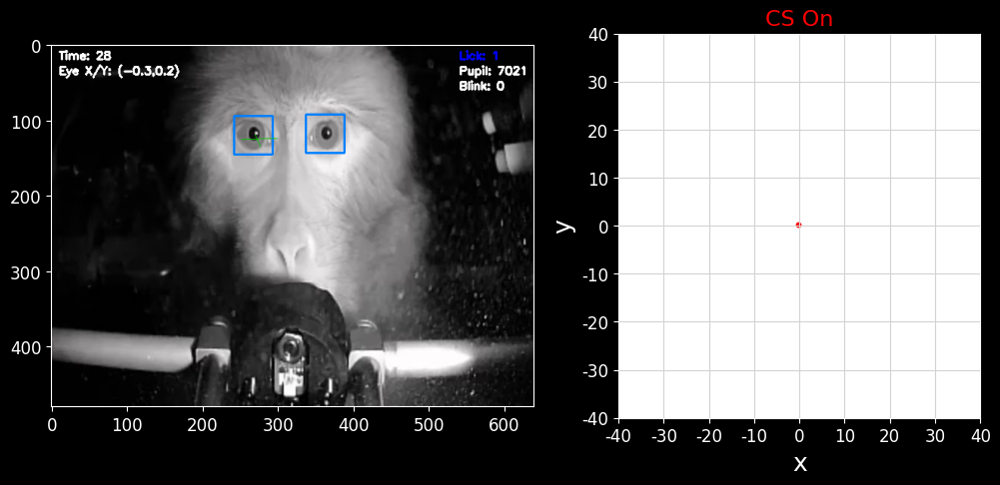

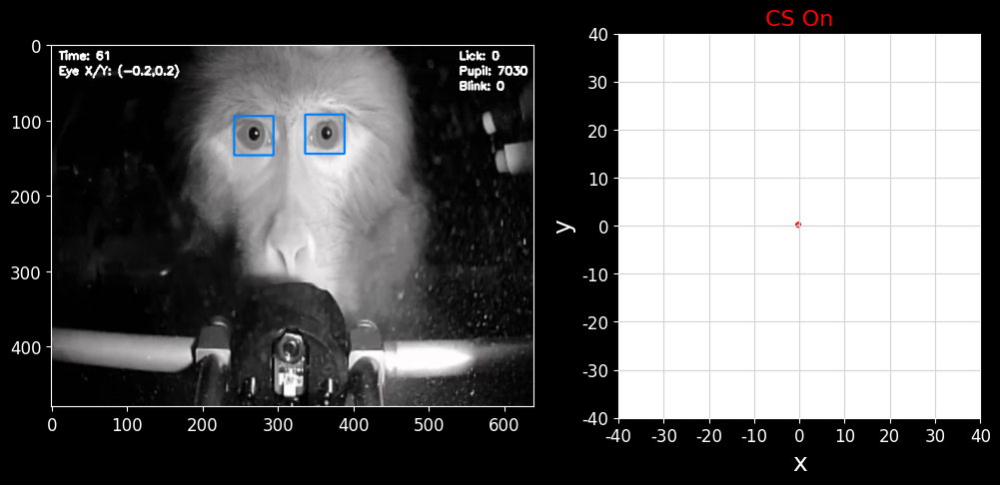

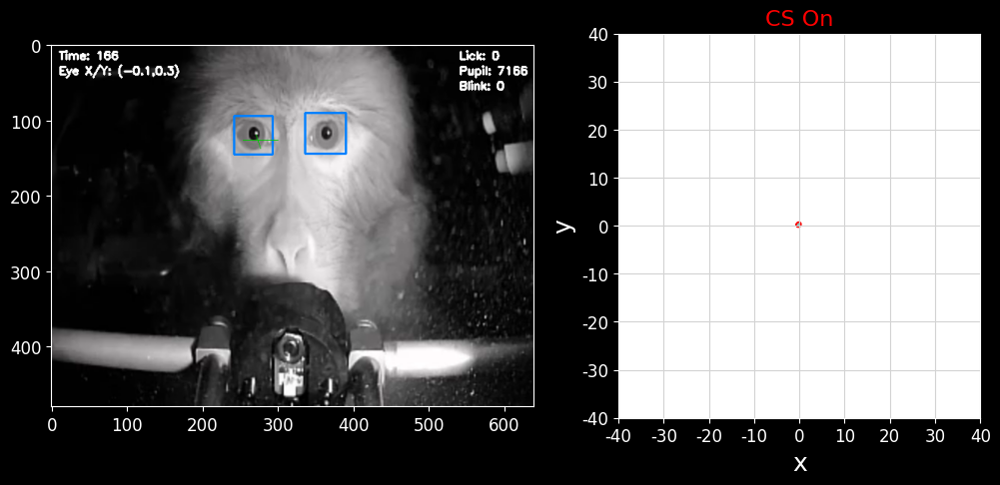

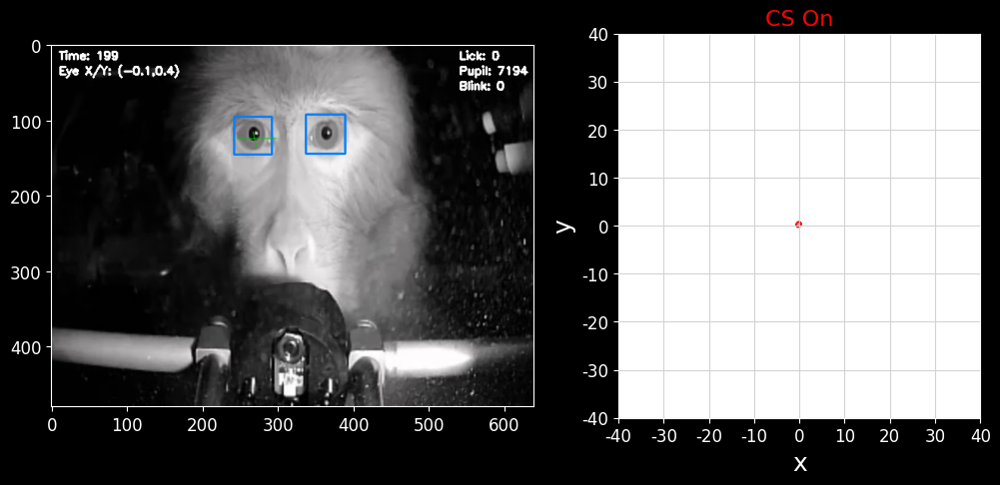

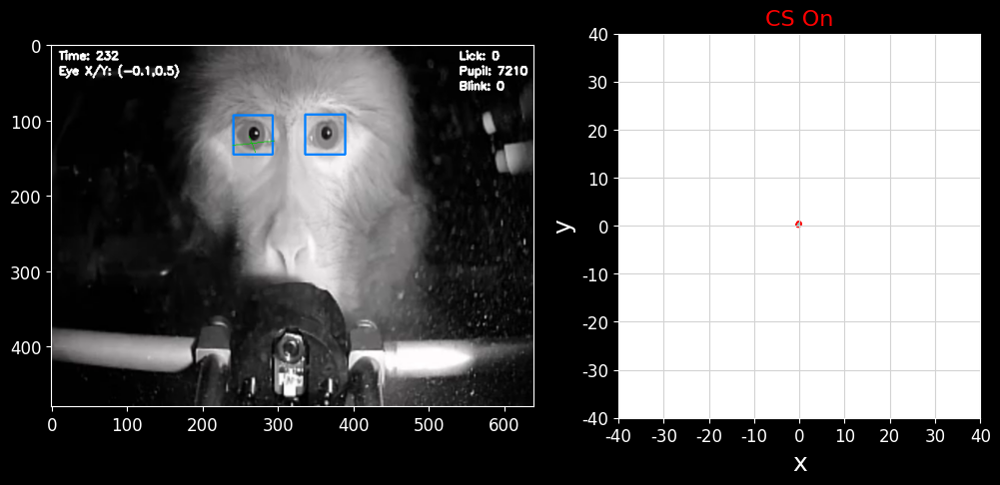

...

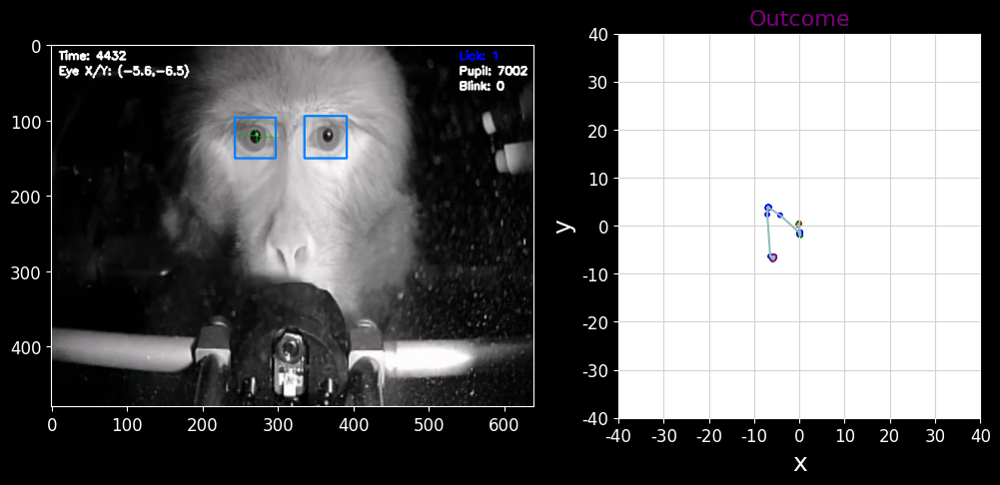

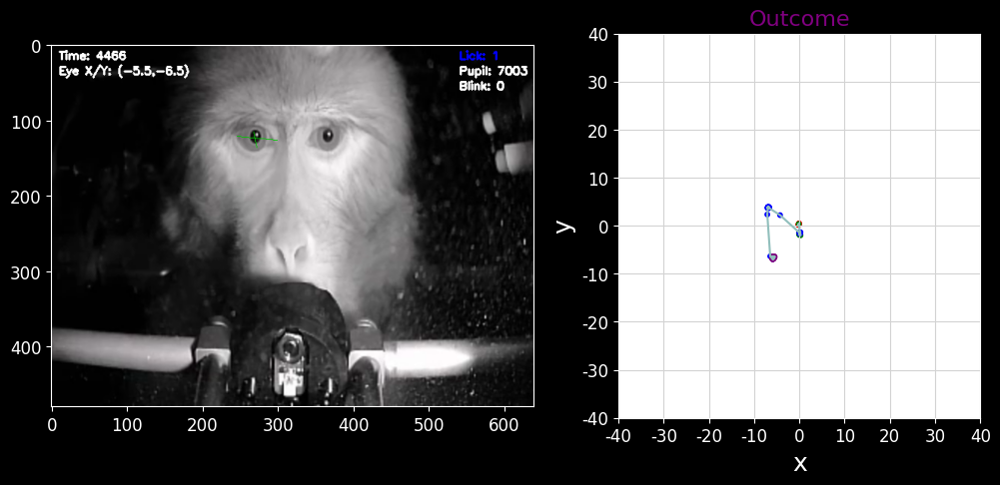

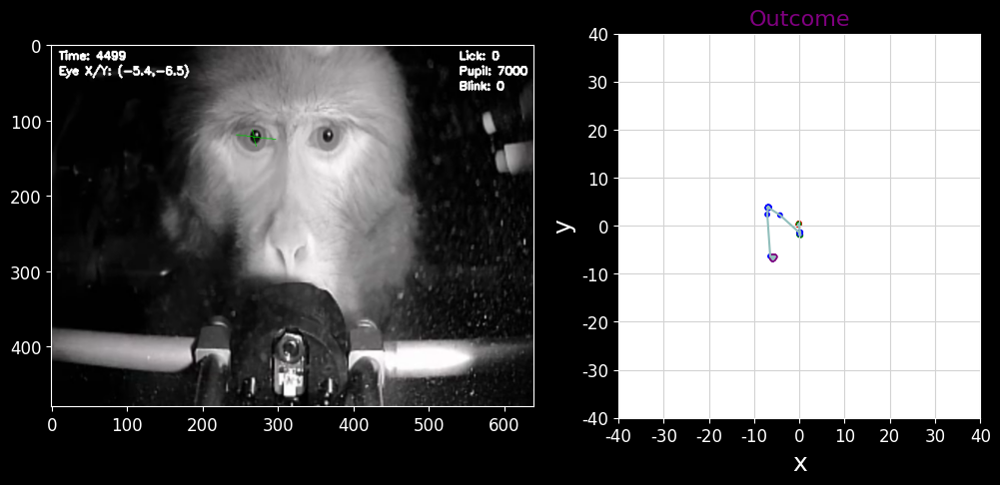

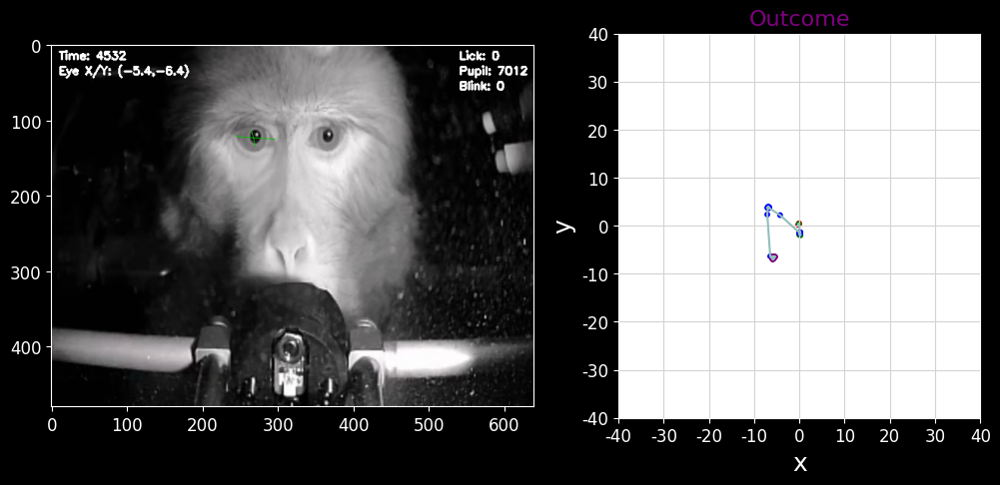

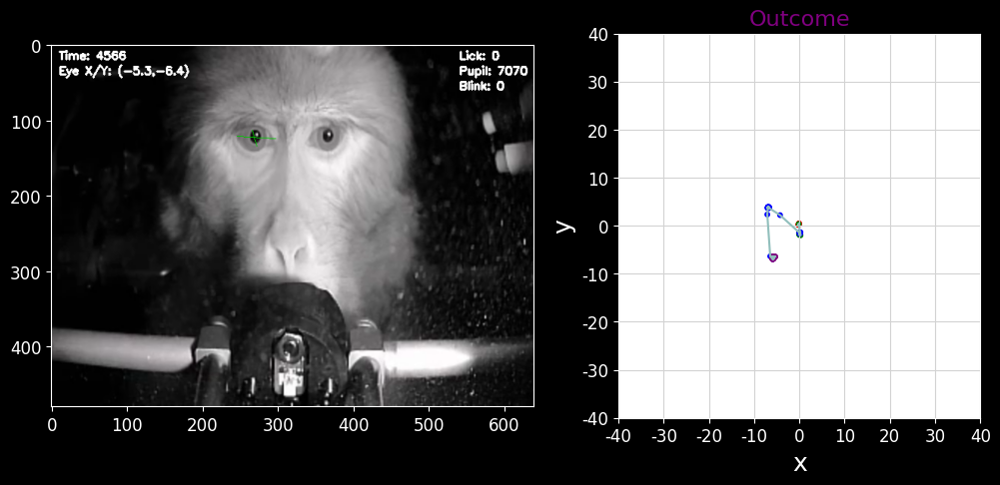

In [23]:
session_df_correct = session_df[session_df['correct'] == 1]
from analyses.video_parsing import video_parsing
video_parsing(session_df_correct, session_obj, trial_specified=trial_specified)

***
## Single Trial Analysis

In [ ]:
session_df_selected = session_df_correct[session_df_correct['trial_num'] == 179]
session_df_selected[['valence',
										 'lick_duration',
										 'blink_duration_sig',
										 'blink_duration_offscreen',
										 'pupil_raster_window_avg',
                  	 'blink_duration_window',
										 'eye_distance',
										 'Outcome Start',
										 'Reward Trigger',
										 'Airpuff Trigger'
]]

In [ ]:
from eyetracking_analysis import eyetracking_analysis
eyetracking_analysis(session_df_selected, session_obj, TRIAL_THRESHOLD=None)

In [ ]:
from session_timing import plot_latency
plot_latency(session_df_correct, session_obj)

***
## Video Analysis

In [ ]:
import matplotlib.pyplot as plt
from plot_helper import set_plot_params

def eye_data_delay(row, trace_window):
	delay_end = row['Trace End']
	eye_x = row['eye_x'][delay_end-trace_window:delay_end]
	eye_y = row['eye_y'][delay_end-trace_window:delay_end]
	row['eye_x_delay'] = eye_x
	row['eye_y_delay'] = eye_y
	return row

def eye_outside_threshold(row):
	blink_count_window = row['blink_count_window']
	eye_x = row['eye_x_delay']
	eye_y = row['eye_y_delay']
	try:
		# print(list(zip(eye_x, eye_y, blink_raster)))
		eye_x_threshold = [x for x_index, x in enumerate(eye_x)
												if blink_count_window[x_index] == 1]
		eye_y_threshold = [y for y_index, y in enumerate(eye_y)
												if blink_count_window[y_index] == 1]
	except:
		eye_x_threshold = []
		eye_y_threshold = []
	row['eye_x_threshold'] = eye_x_threshold
	row['eye_y_threshold'] = eye_y_threshold
	return row

def eye_signal_delay(row, session_obj):
	eye_blink_signal = session_obj.blink_signal
	BLINK_SIGNAL = [(eye_blink_signal['eye_x_min'], eye_blink_signal['eye_y_min']),
									(eye_blink_signal['eye_x_max'], eye_blink_signal['eye_y_max'])]
	eye_x = row['eye_x_delay']
	eye_y = row['eye_y_delay']
	blink_count = [1 if (x,y) in BLINK_SIGNAL else 0 
									for (x,y) in zip(eye_x, eye_y)]
	eye_x_threshold = [x for x_index, x in enumerate(eye_x)
											if blink_count[x_index] == 0]
	eye_y_threshold = [y for y_index, y in enumerate(eye_y)
											if blink_count[y_index] == 0]

	row['eye_x_sig'] = eye_x_threshold
	row['eye_y_sig'] = eye_y_threshold

	return row

def plot_eye_data(session_df, session_obj):
	import seaborn as sns

	# trial_numbers = input('Enter trial numbers to plot (e.g. 1,2,3...{}): '.format(len(session_df)))
	# row = session_df.iloc[int(trial_numbers)]
	# trial_numbers = list(row.index)
	COLORS = session_obj.valence_colors
	session_df = session_df.apply(eye_data_delay, 
					trace_window = session_obj.window_blink, axis=1)
	session_df = session_df.apply(eye_outside_threshold, axis=1)
	session_df = session_df.apply(eye_signal_delay, 
															  session_obj=session_obj,
																axis=1)
	for v_index, valence in enumerate(sorted(session_df['valence'].unique(), reverse=True)):
		set_plot_params(FONT=12,
										AXES_TITLE=16,
										AXES_LABEL=18, 
										TICK_LABEL=12, 
										LEGEND=10, 
										TITLE=20)
		f, ax = plt.subplots(1, 1, figsize=(10, 10))
		df = session_df[session_df['valence'] == valence]
		for index, row in df.iterrows():
			x = row['eye_x_delay']
			y = row['eye_y_delay']
			z = list(range(len(row['eye_x_delay'])))
			scatterplot = ax.scatter(x, y, c=z, cmap='viridis', s=1)
		
		eye_x = df['eye_x_delay'].tolist()
		eye_y = df['eye_y_delay'].tolist()
		x_flatten = [item for sublist in eye_x for item in sublist]
		y_flatten = [item for sublist in eye_y for item in sublist]
		# ax2.hist2d(x_flatten, y_flatten, bins=100, cmap='viridis', 
		# 							range=[[-100, 100], [-100, 100]], 
		# 							density=True)
		sns.jointplot(x=x_flatten, 
									y=y_flatten, 
									color=COLORS[v_index],
									xlim = (-100,100),
									ylim = (-100,100))

		ax.set_title('Valence: {}'.format(valence))
		ax.set_xlim([-100, 100])
		ax.set_ylim([-100, 100])
		f.colorbar(scatterplot, ax=ax)

TRIAL_THRESHOLD = 10
# only include trials after subject has seen fractal <TRIAL_THRESHOLD> number of times
session_df_count = session_df_correct[session_df_correct['fractal_count_in_block'] > TRIAL_THRESHOLD]
plot_eye_data(session_df_count, session_obj)

In [ ]:
for valence in sorted(session_df_correct['valence'].unique()):

  session_valence = session_df_correct[session_df_correct['valence'] == valence]
  # iterate through trials
  f, axarr = plt.subplots(3, 4, figsize=(10, 5))
  # empty matrix of zeros
  lick_matrix_cs = np.zeros((len(session_valence), 350))
  lick_matrix_trace = np.zeros((len(session_valence), 1000))
  lick_matrix_outcome = np.zeros((len(session_valence), 1000))
  blink_matrix_cs = np.zeros((len(session_valence), 350))
  blink_matrix_trace = np.zeros((len(session_valence), 1000))
  blink_matrix_outcome = np.zeros((len(session_valence), 1000))
  iter = 0
  for index, row in session_valence.iterrows():
    # get lick/blink raster
    lick_raster = row['lick_raster']
    blink_raster = row['blink_raster']
    # get cs on/off time
    cs_on = row['CS On']
    cs_off = row['Trace Start']
    lick_raster_cs = lick_raster[cs_on:cs_off][-350:]
    blink_raster_cs = blink_raster[cs_on:cs_off][-350:]
    # replace zeros in blink matrix with blink raster
    lick_matrix_cs[iter, :len(lick_raster_cs)] = lick_raster_cs
    blink_matrix_cs[iter, :len(blink_raster_cs)] = blink_raster_cs
    # get trace end/trial end time
    if valence > 0:
      trace_end = row['Reward Trigger']
    elif valence < 0:
      trace_end = row['Airpuff Trigger']
    else:
      trace_end = row['Trace End']
    trial_end = row['End Trial']
    lick_trace = lick_raster[cs_off:trace_end][-1000:]
    blink_trace = blink_raster[cs_off:trace_end][-1000:]
    # replace zeros in blink matrix with blink trace
    lick_matrix_trace[iter, :len(lick_trace)] = lick_trace
    blink_matrix_trace[iter, :len(blink_trace)] = blink_trace
    # get outcome time
    lick_raster_outcome = lick_raster[trace_end:trial_end][:1000]
    blink_raster_outcome = blink_raster[trace_end:trial_end][:1000]
    # replace zeros in blink matrix with blink outcome
    lick_matrix_outcome[iter, :len(lick_raster_outcome)] = lick_raster_outcome
    blink_matrix_outcome[iter, :len(blink_raster_outcome)] = blink_raster_outcome
    iter += 1
  axarr[0][0].imshow(lick_matrix_cs, aspect='auto')
  axarr[1][0].imshow(lick_matrix_trace, aspect='auto')
  axarr[2][0].imshow(lick_matrix_outcome, aspect='auto')
  axarr[0][2].imshow(blink_matrix_cs, aspect='auto')
  axarr[1][2].imshow(blink_matrix_trace, aspect='auto')
  axarr[2][2].imshow(blink_matrix_outcome, aspect='auto')
  # get column average of matrix
  ## cs
  lick_matrix_cs_avg = np.mean(lick_matrix_cs, axis=0)
  blink_matrix_cs_avg = np.mean(blink_matrix_cs, axis=0)
  axarr[0][1].plot(lick_matrix_cs_avg)
  axarr[0][1].set_ylim([0, 1])
  axarr[0][3].plot(blink_matrix_cs_avg)
  axarr[0][3].set_ylim([0, 1])
  ## trace
  lick_matrix_trace_avg = np.mean(lick_matrix_trace, axis=0)
  blink_matrix_trace_avg = np.mean(blink_matrix_trace, axis=0)
  axarr[1][1].plot(lick_matrix_trace_avg)
  axarr[1][1].set_ylim([0, 1])
  axarr[1][3].plot(blink_matrix_trace_avg)
  axarr[1][3].set_ylim([0, 1])
  ## outcome
  lick_matrix_outcome_avg = np.mean(lick_matrix_outcome, axis=0)
  blink_matrix_outcome_avg = np.mean(blink_matrix_outcome, axis=0)
  axarr[2][1].plot(lick_matrix_outcome_avg)
  axarr[2][1].set_ylim([0, 1])
  axarr[2][3].plot(blink_matrix_outcome_avg)
  axarr[2][3].set_ylim([0, 1])
  # set x labels
  axarr[0][0].set_title('Lick Raster')
  axarr[0][1].set_title('Lick Average')
  axarr[0][2].set_title('Blink Raster')
  axarr[0][3].set_title('Blink Average')
  # set y labels
  axarr[0][0].set_ylabel('CS')
  axarr[1][0].set_ylabel('Trace')
  axarr[2][0].set_ylabel('Outcome')
  # use super title to set title over all subplots 
  f.suptitle('Valence: {}'.format(valence), fontsize=22)
  # reduce height of title
  f.tight_layout()
  plt.show()

In [21]:
session_df_correct = session_df[session_df['correct'] == 1]
session_choice = session_df_correct[session_df_correct['choice_trial'] == 1]
# max number of rows to display
pd.set_option('display.max_rows', 1000)
session_choice[['condition', 'trial_in_block', 'stimuli_name_1', 'valence_1', 'stimuli_name_2', 'valence_2', 'fractal_chosen', 'valence']]

,condition,trial_in_block,stimuli_name_1,valence_1,stimuli_name_2,valence_2,fractal_chosen,valence
14,1,14,_fractal_B,0.5,_fractal_E,-1.0,_fractal_E,-1.0
27,1,27,_fractal_B,0.5,_fractal_D,-0.5,_fractal_D,-0.5
29,1,29,_fractal_E,-1.0,_fractal_C,0.0,_fractal_C,0.0
30,1,30,_fractal_E,-1.0,_fractal_B,0.5,_fractal_B,0.5
33,1,33,_fractal_B,0.5,_fractal_E,-1.0,_fractal_E,-1.0
46,1,46,_fractal_E,-1.0,_fractal_A,1.0,_fractal_A,1.0
58,1,58,_fractal_E,-1.0,_fractal_D,-0.5,_fractal_D,-0.5
61,1,61,_fractal_B,0.5,_fractal_E,-1.0,_fractal_E,-1.0
84,1,84,_fractal_D,-0.5,_fractal_B,0.5,_fractal_B,0.5
94,1,94,_fractal_A,1.0,_fractal_B,0.5,_fractal_A,1.0


***
### Write Results to Excel

In [28]:
session_df_correct['cam2_video']

0     NaN
1     NaN
2     NaN
4     NaN
6     NaN
       ..
651   NaN
653   NaN
655   NaN
656   NaN
657   NaN
Name: cam2_video, Length: 451, dtype: float64

In [11]:
session_df_choice = session_df[session_df['choice_trial'] == 1]
# see percent correct
session_df_choice['Trace Start'] - session_df_choice['Fixation Off']

13     <NA>
14      384
17     <NA>
18      400
22     <NA>
       ... 
818    <NA>
819    <NA>
820    <NA>
821     377
826     384
Length: 383, dtype: object